In [ ]:
import pandas as pd
from sklearn.manifold import TSNE
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import preprocessing
import warnings
from random import randint
import scipy.stats as sts
import plotly.express as px
import time
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import silhouette_score
from sklearn.metrics import rand_score
from sklearn.cluster import KMeans
import plotly.graph_objects as go
from sklearn.cluster import AgglomerativeClustering

warnings.filterwarnings('ignore')

df = pd.read_csv('primary-tumor.data', on_bad_lines='skip', header=None)
df.rename(columns={0: 'class', 1: 'age', 2: 'sex', 3: 'histologic-type', 4: 'degree-of-diffe', 5: 'bone', 6: 'bone-marrow', 7: 'lung', 8: 'pleura', 9: 'peritoneum', 10: 'liver', 11: 'brain', 12: 'skin', 13: 'neck', 14: 'supraclavicular', 15: 'axillar', 16: 'mediastinum', 17: 'abdominal'}, inplace=True)
df.drop(['histologic-type','degree-of-diffe'], axis = 1, inplace=True)

SexIndexes = df.index[df['sex'].str.match('\?')].tolist()
for index in SexIndexes:
  if (df.iloc[index])['class'] == '22' or (df.iloc[index])['class'] == '21' or (df.iloc[index])['class'] == '20' or (df.iloc[index])['class'] == '19':
    df.at[index, 'sex'] = 2
  elif (df.iloc[index])['class'] == '18' or (df.iloc[index])['class'] == '17' or (df.iloc[index])['class'] == '16':
    df.at[index, 'sex'] = 1
  else:
    df.at[index, 'sex'] = randint(1,2)
df['sex'] = pd.to_numeric(df['sex'])

SkinIndexes = df.index[df['skin'].str.match('\?')].tolist()
for index in SkinIndexes:
  df.at[index, 'skin'] = randint(1,2)
df['skin'] = pd.to_numeric(df['skin'])

AxillarIndexes = df.index[df['axillar'].str.match('\?')].tolist()
for index in AxillarIndexes:
  df.at[index, 'axillar'] = randint(1,2)
df['axillar'] = pd.to_numeric(df['axillar'])

df

,class,age,sex,bone,bone-marrow,lung,pleura,peritoneum,liver,brain,skin,neck,supraclavicular,axillar,mediastinum,abdominal
0,1,1,1,2,2,1,2,2,2,2,2,2,2,2,2,2
1,1,1,1,2,2,2,2,2,1,2,2,2,1,2,1,2
2,1,1,2,1,2,2,2,2,2,2,2,2,2,2,1,2
3,1,1,2,1,2,1,1,2,2,2,2,2,2,2,1,2
4,1,1,2,1,2,1,1,2,2,2,2,2,2,2,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
334,22,2,2,2,2,2,2,2,2,2,2,2,2,1,2,2
335,22,2,2,2,2,2,2,2,2,2,2,2,2,1,2,2
336,22,2,2,1,2,2,2,2,2,2,2,2,1,1,2,2
337,22,3,2,2,2,2,2,2,2,2,2,1,1,1,2,2


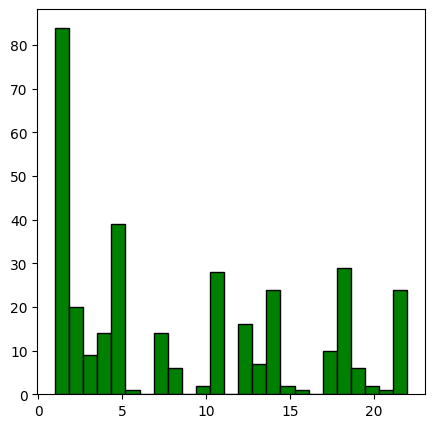

1     84
5     39
18    29
11    28
14    24
22    24
2     20
12    16
7     14
4     14
17    10
3      9
13     7
8      6
19     6
10     2
15     2
20     2
6      1
16     1
21     1
Name: class, dtype: int64

In [ ]:
fig, ax = plt.subplots(figsize = (5, 5))
ax.hist(df['class'], edgecolor = 'black', color='green', bins=25)
plt.show()
df['class'].value_counts()

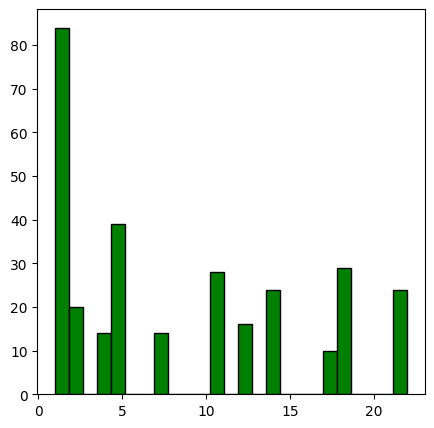

1     84
5     39
18    29
11    28
14    24
22    24
2     20
12    16
4     14
7     14
17    10
Name: class, dtype: int64

In [ ]:
deleteArray = []
for index, row in df.iterrows():
  if df['class'][index] == 21:
    deleteArray.append(index)
  if df['class'][index] == 16:
    deleteArray.append(index)
  if df['class'][index] == 6:
    deleteArray.append(index)
  if df['class'][index] == 20:
    deleteArray.append(index)
  if df['class'][index] == 15:
    deleteArray.append(index)
  if df['class'][index] == 10:
    deleteArray.append(index)
  if df['class'][index] == 3:
    deleteArray.append(index)
  if df['class'][index] == 13:
    deleteArray.append(index)
  if df['class'][index] == 8:
    deleteArray.append(index)
  if df['class'][index] == 19:
    deleteArray.append(index)

#print(deleteArray)
df.drop(index = deleteArray, inplace=True)

fig, ax = plt.subplots(figsize = (5, 5))
ax.hist(df['class'], edgecolor = 'black', color='green', bins=25)
plt.show()
df['class'].value_counts()

In [ ]:
dfX = df.copy()

dfX.drop(['class'], axis = 1, inplace=True)

dfX

,age,sex,bone,bone-marrow,lung,pleura,peritoneum,liver,brain,skin,neck,supraclavicular,axillar,mediastinum,abdominal
0,1,1,2,2,1,2,2,2,2,2,2,2,2,2,2
1,1,1,2,2,2,2,2,1,2,2,2,1,2,1,2
2,1,2,1,2,2,2,2,2,2,2,2,2,2,1,2
3,1,2,1,2,1,1,2,2,2,2,2,2,2,1,2
4,1,2,1,2,1,1,2,2,2,2,2,2,2,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
334,2,2,2,2,2,2,2,2,2,2,2,2,1,2,2
335,2,2,2,2,2,2,2,2,2,2,2,2,1,2,2
336,2,2,1,2,2,2,2,2,2,2,2,1,1,2,2
337,3,2,2,2,2,2,2,2,2,2,1,1,1,2,2


In [ ]:
dfY = df['class']

dfY

0       1
1       1
2       1
3       1
4       1
       ..
334    22
335    22
336    22
337    22
338    22
Name: class, Length: 302, dtype: int64

In [ ]:
models = []
score1 = []
score2 = []

for i in range(2, 10):
  model = KMeans(n_clusters=i).fit(dfX)
  models.append(model)
  score1.append(model.inertia_)
  score2.append(silhouette_score(dfX, model.labels_))

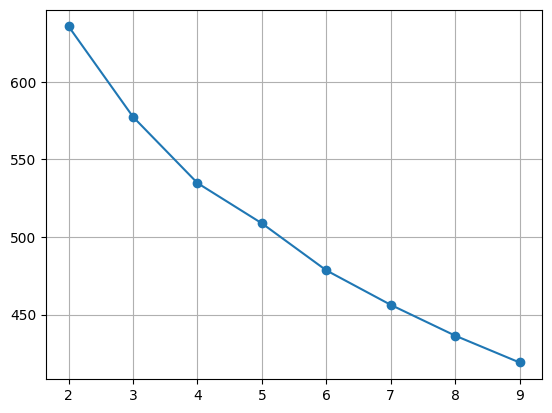

In [ ]:
plt.grid()
plt.plot(np.arange(2, 10), score1, marker='o')
plt.show()

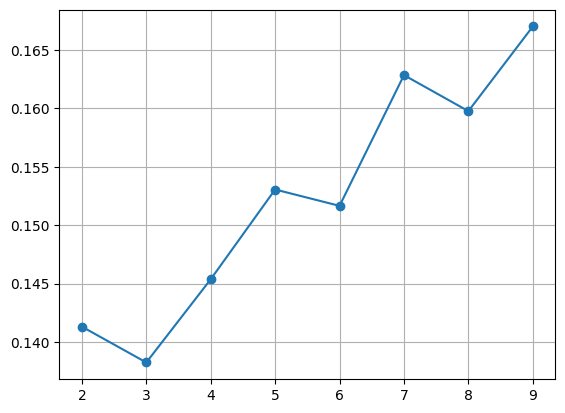

In [ ]:
plt.grid()
plt.plot(np.arange(2, 10), score2, marker='o')
plt.show()

In [ ]:
model1 = KMeans(n_clusters=9)
model1.fit(dfX)
model1.cluster_centers_

array([[2.69565217, 1.65217391, 1.69565217, 2.        , 1.04347826,
        1.60869565, 1.7826087 , 1.17391304, 1.91304348, 1.95652174,
        2.        , 1.95652174, 2.        , 1.34782609, 1.08695652],
       [1.975     , 1.5       , 1.7       , 2.        , 1.8       ,
        1.875     , 1.925     , 1.85      , 1.95      , 1.925     ,
        1.7       , 1.        , 1.6       , 1.5       , 1.825     ],
       [1.93939394, 1.42424242, 2.        , 2.        , 1.90909091,
        1.81818182, 2.        , 1.72727273, 1.84848485, 1.87878788,
        2.        , 2.        , 1.6969697 , 1.78787879, 1.96969697],
       [2.0625    , 1.        , 1.8125    , 1.875     , 1.625     ,
        1.4375    , 1.5625    , 1.625     , 1.625     , 1.9375    ,
        1.9375    , 1.9375    , 1.9375    , 1.125     , 1.        ],
       [2.94871795, 1.84615385, 1.94871795, 1.97435897, 1.97435897,
        1.92307692, 1.97435897, 1.33333333, 2.        , 2.        ,
        2.        , 1.94871795, 2.        , 

In [ ]:
labelsKMeans = model1.labels_
unique, counts = np.unique(labelsKMeans, return_counts=True)

np.asarray((unique, counts)).T

array([[ 0, 23],
       [ 1, 40],
       [ 2, 33],
       [ 3, 16],
       [ 4, 39],
       [ 5, 55],
       [ 6, 23],
       [ 7, 41],
       [ 8, 32]])

In [ ]:
rand_score(dfY, labelsKMeans)

0.8024245891179512

In [ ]:
tsne = TSNE(n_components=2, learning_rate='auto', init='random', perplexity=5)
tsne_results = tsne.fit_transform(dfX)

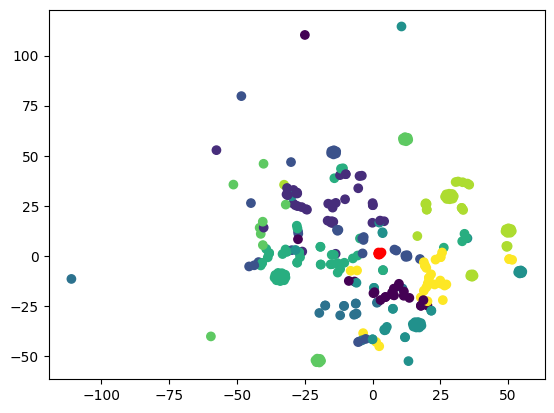

In [ ]:
plt.scatter(tsne_results[:,0], tsne_results[:,1], c=labelsKMeans)
plt.scatter(model1.cluster_centers_[:,0], model1.cluster_centers_[:,1], color='red')

plt.show()

In [ ]:
!pip install umap-learn
import umap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 90.8/90.8 kB 2.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 24.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for umap-learn: filename=umap_learn-0.5.4-py3-none-any.whl size=86770 sha256=bebedbd33efc4bc3638ad375e56a807c2a88d86b2bd678fdfa594ad853474e5d
  Stored in directory: /root/.cache/pip/wheels/fb/66/29/199acf5784d0f7b8add6d466175ab45506c96e386ed5dd0633
  Created wheel for pynndescent: filename=pynndescent-0.5.10-py3-none-any.whl size=55615 sha256=964d1541f945576609308c456a540d7eaf65de697f8b0d4988e72c12936b1d80
  Stored in directory: /root/.cache/pip/wheels/4a/38/5d/f60a40a66a9512b7e5e83517ebc2d1b42d857be97d135f1096
Successfully built umap-learn pynndescent


In [ ]:
fit = umap.UMAP(n_neighbors=2, min_dist=0.99)
u = fit.fit_transform(dfX)

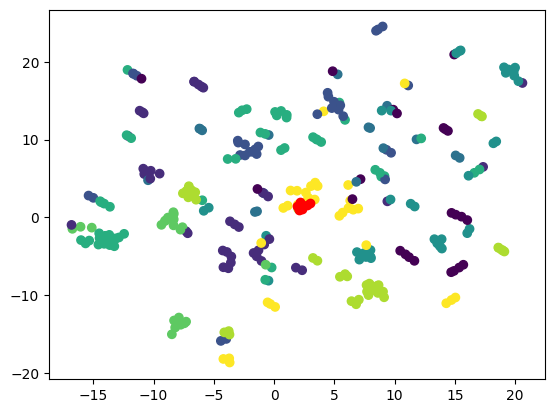

In [ ]:
plt.scatter(u[:,0], u[:,1], c=labelsKMeans)
plt.scatter(model1.cluster_centers_[:,0], model1.cluster_centers_[:,1], color='red')

plt.show()

In [ ]:
model2 = AgglomerativeClustering(9, compute_distances=True)
clastering=model2.fit(dfX)

labelsAC=clastering.labels_

unique, counts = np.unique(labelsAC, return_counts=True)

np.asarray((unique, counts)).T

array([[ 0, 45],
       [ 1, 46],
       [ 2, 40],
       [ 3, 22],
       [ 4, 54],
       [ 5, 24],
       [ 6, 15],
       [ 7, 34],
       [ 8, 22]])

In [ ]:
rand_score(dfY, labelsAC)

0.8021165650920772

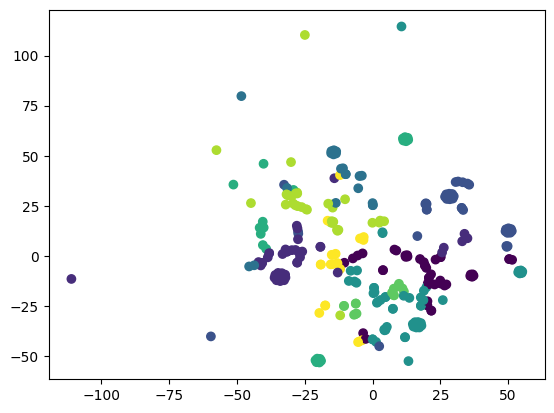

In [ ]:
plt.scatter(tsne_results[:,0], tsne_results[:,1], c=labelsAC)

plt.show()

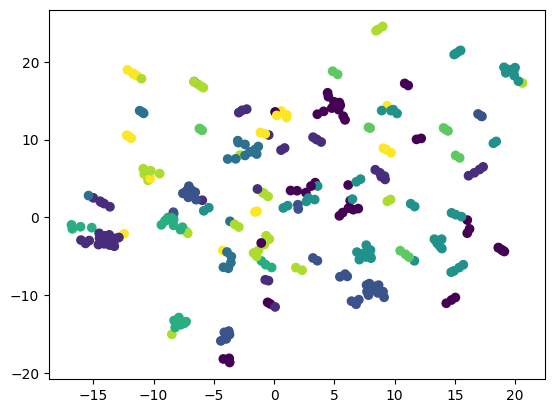

In [ ]:
plt.scatter(u[:,0], u[:,1], c=labelsAC)

plt.show()

In [ ]:
data = pd.read_csv('marketing_campaign.csv', sep="\t")

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

In [ ]:
data.describe()

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
count,2240.000000,2240.000000,2216.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,...,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.0,2240.0,2240.000000
mean,5592.159821,1968.805804,52247.251354,0.444196,0.506250,49.109375,303.935714,26.302232,166.950000,37.525446,...,5.316518,0.072768,0.074554,0.072768,0.064286,0.013393,0.009375,3.0,11.0,0.149107
std,3246.662198,11.984069,25173.076661,0.538398,0.544538,28.962453,336.597393,39.773434,225.715373,54.628979,...,2.426645,0.259813,0.262728,0.259813,0.245316,0.114976,0.096391,0.0,0.0,0.356274
min,0.000000,1893.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
25%,2828.250000,1959.000000,35303.000000,0.000000,0.000000,24.000000,23.750000,1.000000,16.000000,3.000000,...,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
50%,5458.500000,1970.000000,51381.500000,0.000000,0.000000,49.000000,173.500000,8.000000,67.000000,12.000000,...,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
75%,8427.750000,1977.000000,68522.000000,1.000000,1.000000,74.000000,504.250000,33.000000,232.000000,50.000000,...,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
max,11191.000000,1996.000000,666666.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,...,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,3.0,11.0,1.000000


In [ ]:
data.columns

Index(['ID', 'Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Z_CostContact', 'Z_Revenue', 'Response'],
      dtype='object')

In [ ]:
num_cols = list(data.select_dtypes(['int64', 'float64']))
num_cols

['ID',
 'Year_Birth',
 'Income',
 'Kidhome',
 'Teenhome',
 'Recency',
 'MntWines',
 'MntFruits',
 'MntMeatProducts',
 'MntFishProducts',
 'MntSweetProducts',
 'MntGoldProds',
 'NumDealsPurchases',
 'NumWebPurchases',
 'NumCatalogPurchases',
 'NumStorePurchases',
 'NumWebVisitsMonth',
 'AcceptedCmp3',
 'AcceptedCmp4',
 'AcceptedCmp5',
 'AcceptedCmp1',
 'AcceptedCmp2',
 'Complain',
 'Z_CostContact',
 'Z_Revenue',
 'Response']

In [ ]:
len(num_cols)

26

<function matplotlib.pyplot.show(close=None, block=None)>

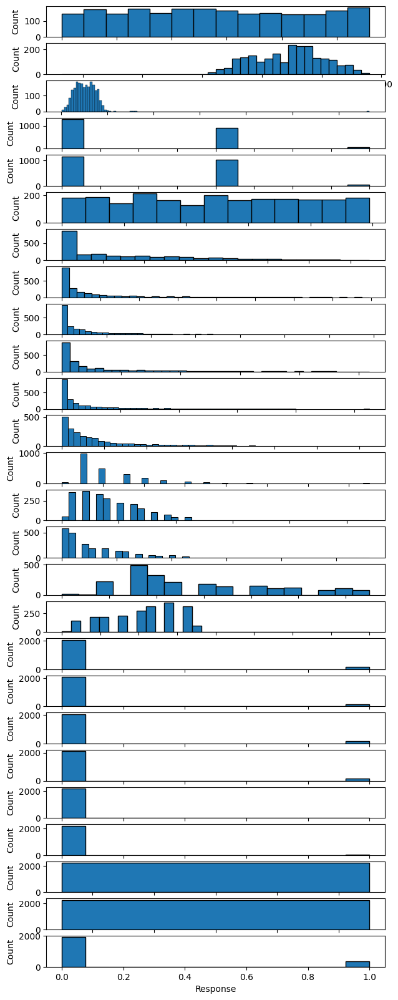

In [ ]:
fig, ax = plt.subplots(ncols = 1, nrows = len(num_cols), figsize=(7, 20))
i=0
for col in num_cols:
  sns.histplot(x=data[col], fill=True, alpha=1, ax=ax[i])
  i=i+1
plt.show

In [ ]:
skew = []
for col in num_cols:
  skew.append(round(data[col].skew(),len(num_cols)))
num_skew = pd.DataFrame({'Column': num_cols, 'skewness':skew})
num_skew

,Column,skewness
0,ID,0.039832
1,Year_Birth,-0.349944
2,Income,6.763487
3,Kidhome,0.635288
4,Teenhome,0.407115
5,Recency,-0.001987
6,MntWines,1.175771
7,MntFruits,2.102063
8,MntMeatProducts,2.083233
9,MntFishProducts,1.919769


<function matplotlib.pyplot.show(close=None, block=None)>

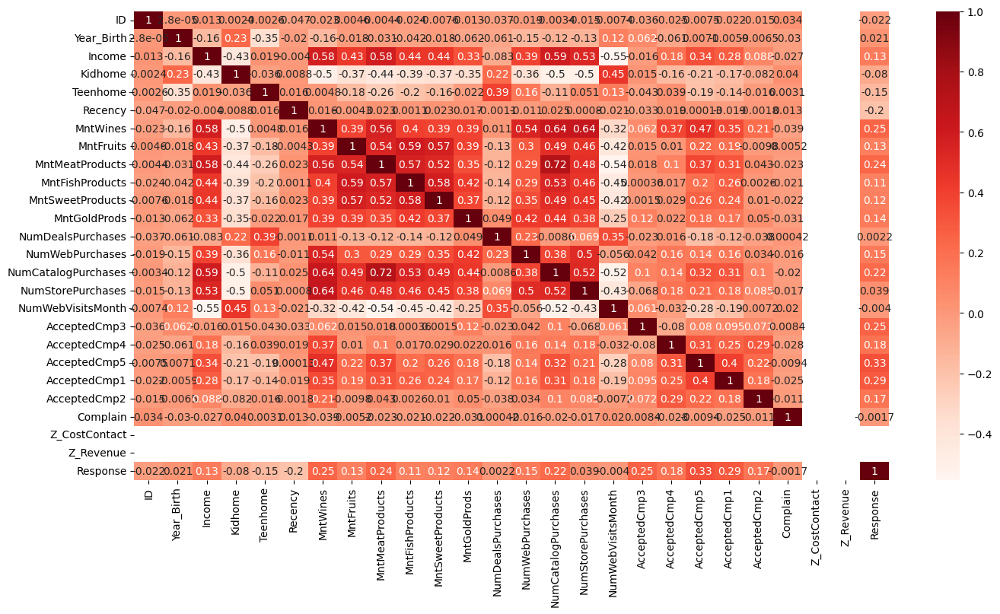

In [ ]:
corr = data[num_cols].corr()
plt.figure(figsize=(16, 8))
sns.heatmap(corr, cmap="Reds", annot=True)
plt.show

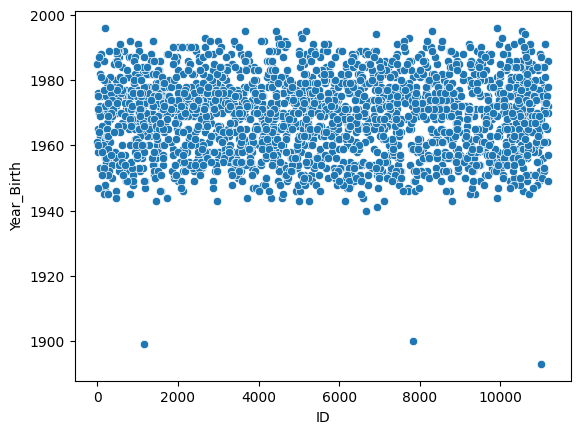

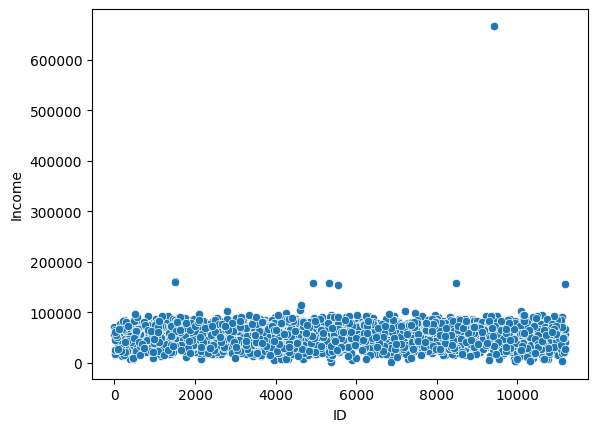

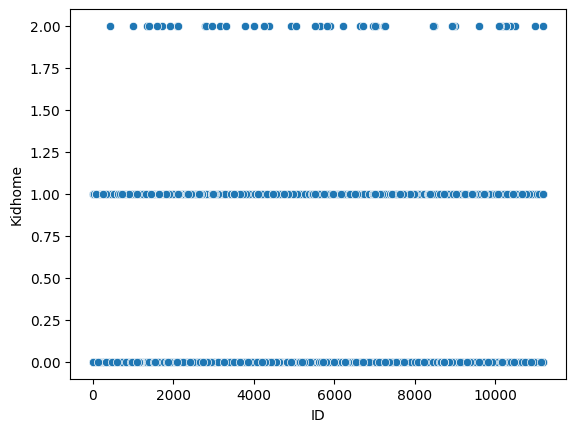

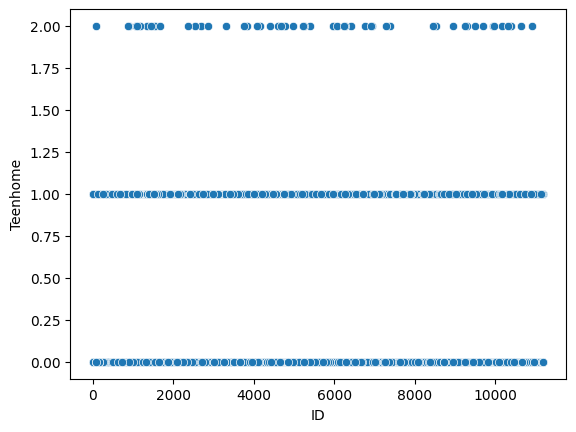

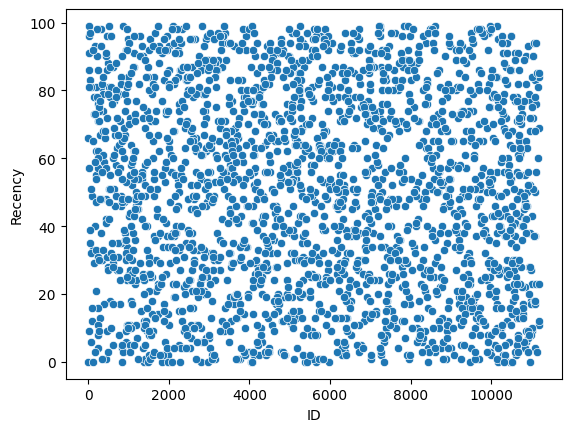

...

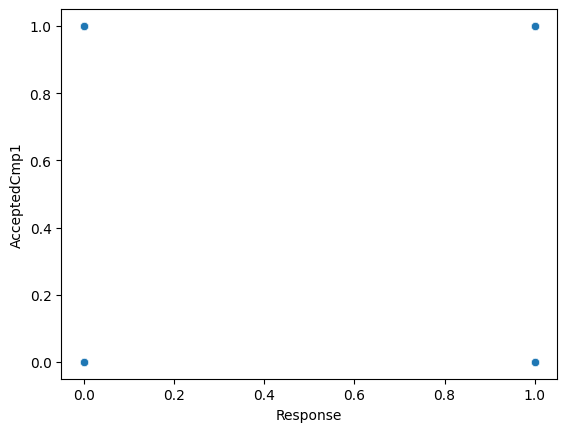

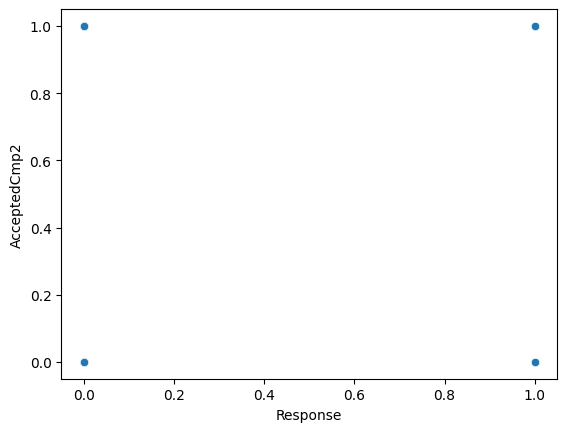

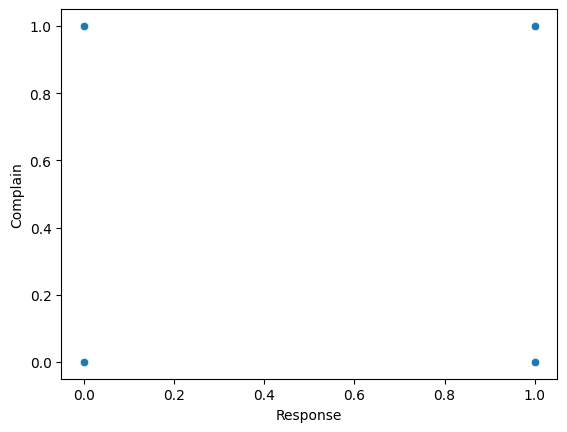

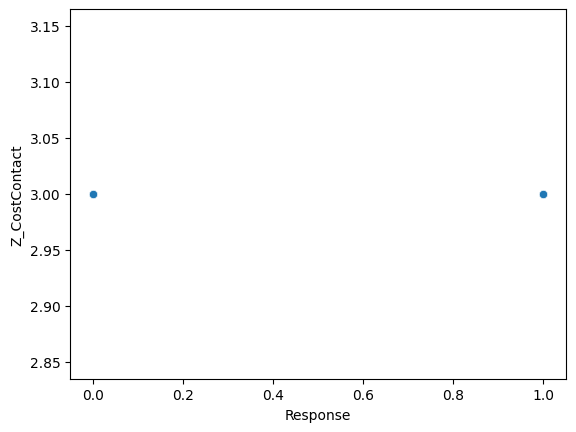

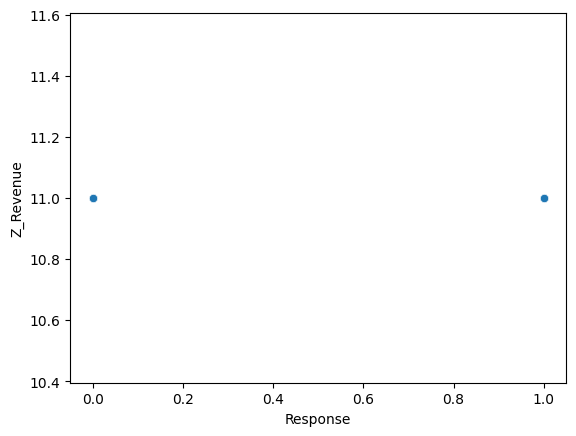

In [ ]:
for col1 in num_cols:
  for col2 in num_cols:
    if (col1!=col2):
      sns.scatterplot(data=data[num_cols], x=col1, y=col2)
      plt.show()

<function matplotlib.pyplot.show(close=None, block=None)>

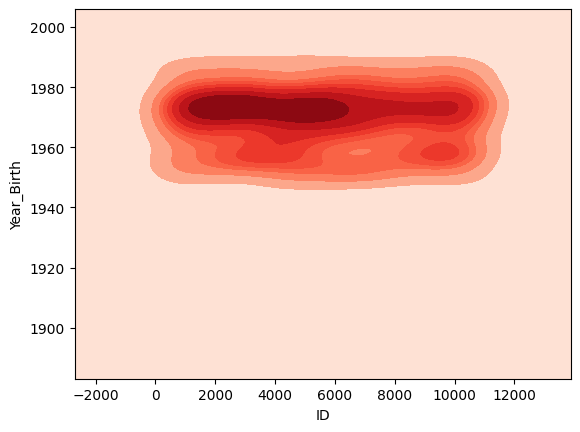

In [ ]:
sns.kdeplot(x=data['ID'], y=data['Year_Birth'], cmap="Reds", shade=True, thresh=0)
plt.show

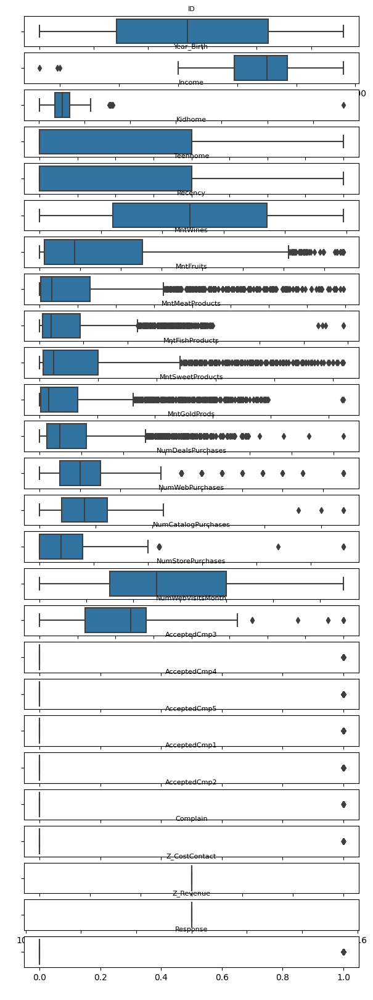

In [ ]:
fig, ax = plt.subplots(ncols = 1, nrows = len(num_cols), figsize=(7, 20))
i=0
for col in num_cols:
  sns.boxplot(data=data[num_cols], x=col, ax=ax[i])
  ax[i].set_xlabel('   ')
  ax[i].set_ylabel('   ')
  ax[i].set_title(col, fontsize=8)
  i=i+1
plt.show()

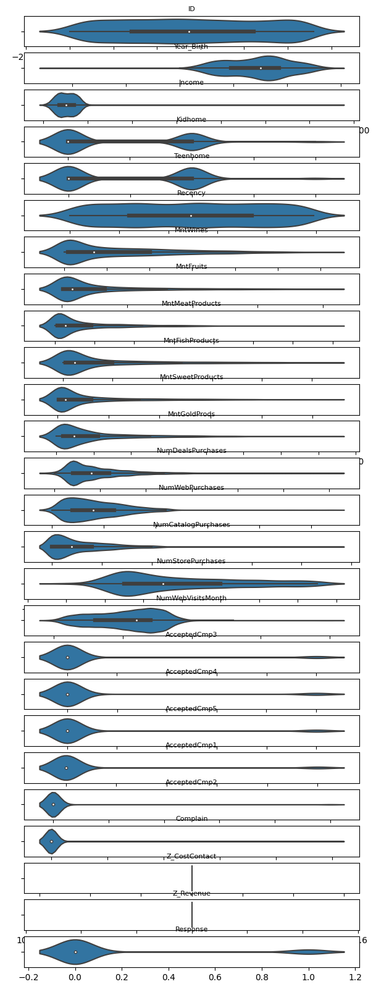

In [ ]:
fig, ax = plt.subplots(ncols = 1, nrows = len(num_cols), figsize=(7, 20))
i=0
for col in num_cols:
  sns.violinplot(data=data[num_cols], x=col, ax=ax[i])
  ax[i].set_xlabel('   ')
  ax[i].set_ylabel('   ')
  ax[i].set_title(col, fontsize=8)
  i=i+1
plt.show()

In [ ]:
outlier_dict_if={}
outlier_dict_unique_if={}
for col in num_cols:
  stats = data[col].describe()
  q1, q3 = stats['25%'], stats['75%']
  iqr=q3-q1
  lower_bound_if = q1-(1.5*iqr)
  upper_bound_if = q3+(1.5*iqr)

  outlier_list_if=[]
  outlier_list_unique_if=[]
  for x in data[col]:
    if ((x>upper_bound_if) or (x<lower_bound_if)):
      outlier_list_if.append(x)
      if x not in outlier_list_unique_if:
        outlier_list_unique_if.append(x)
    outlier_dict_if['{}'.format(col)] = outlier_list_if
    outlier_dict_unique_if['{}'.format(col)] = outlier_list_unique_if

In [ ]:
for k, v in outlier_dict_if.items():
  print(k, v,'\n')

ID [] 

Year_Birth [1900, 1893, 1899] 

Income [157243.0, 162397.0, 153924.0, 160803.0, 157733.0, 157146.0, 156924.0, 666666.0] 

Kidhome [] 

Teenhome [] 

Recency [] 

MntWines [1332, 1349, 1241, 1285, 1248, 1239, 1396, 1288, 1379, 1478, 1492, 1492, 1279, 1308, 1478, 1253, 1394, 1296, 1285, 1230, 1315, 1298, 1302, 1449, 1259, 1252, 1459, 1493, 1324, 1285, 1462, 1276, 1245, 1486, 1311] 

MntFruits [88, 100, 164, 120, 107, 111, 105, 172, 106, 194, 115, 99, 90, 133, 106, 162, 189, 138, 86, 114, 153, 134, 148, 84, 162, 129, 98, 183, 129, 147, 138, 153, 144, 104, 91, 163, 134, 152, 105, 114, 137, 190, 96, 84, 162, 138, 83, 92, 134, 155, 151, 85, 129, 153, 129, 183, 127, 91, 107, 129, 103, 89, 105, 181, 112, 159, 134, 102, 86, 123, 166, 142, 133, 178, 93, 107, 97, 115, 168, 91, 148, 174, 122, 123, 91, 199, 102, 138, 101, 92, 99, 111, 152, 86, 98, 85, 107, 137, 138, 168, 93, 114, 98, 172, 96, 114, 83, 117, 114, 178, 108, 130, 161, 138, 124, 126, 105, 83, 120, 142, 104, 100, 83, 106, 161, 18

In [ ]:
for k, v in outlier_dict_unique_if.items():
  print(k, v,'\n')

ID [] 

Year_Birth [1900, 1893, 1899] 

Income [157243.0, 162397.0, 153924.0, 160803.0, 157733.0, 157146.0, 156924.0, 666666.0] 

Kidhome [] 

Teenhome [] 

Recency [] 

MntWines [1332, 1349, 1241, 1285, 1248, 1239, 1396, 1288, 1379, 1478, 1492, 1279, 1308, 1253, 1394, 1296, 1230, 1315, 1298, 1302, 1449, 1259, 1252, 1459, 1493, 1324, 1462, 1276, 1245, 1486, 1311] 

MntFruits [88, 100, 164, 120, 107, 111, 105, 172, 106, 194, 115, 99, 90, 133, 162, 189, 138, 86, 114, 153, 134, 148, 84, 129, 98, 183, 147, 144, 104, 91, 163, 152, 137, 190, 96, 83, 92, 155, 151, 85, 127, 103, 89, 181, 112, 159, 102, 123, 166, 142, 178, 93, 97, 168, 174, 122, 199, 101, 117, 108, 130, 161, 124, 126, 185, 87, 197, 82, 184, 160, 140, 131, 132, 169, 193, 149, 143, 154] 

MntMeatProducts [1725, 801, 780, 925, 779, 568, 690, 812, 951, 590, 921, 756, 1582, 813, 740, 757, 768, 565, 573, 561, 570, 562, 832, 785, 818, 815, 786, 591, 716, 792, 974, 594, 613, 670, 761, 940, 797, 635, 592, 572, 732, 713, 653, 758, 711, 8

In [ ]:
after_removel_if = data[num_cols]

for col in num_cols:
  stats = data[col].describe()
  q1, q3 = stats['25%'], stats['75%']
  iqr=q3-q1
  lower_bound_if = q1-(1.5*iqr)
  upper_bound_if = q3+(1.5*iqr)
  after_removel_if = after_removel_if[(after_removel_if[col]>=lower_bound_if) & (after_removel_if[col]<=upper_bound_if)]

removed_if = 100*(data[num_cols].shape[0] - after_removel_if.shape[0])/data[num_cols].shape[0]
removed_if

46.785714285714285

In [ ]:
models = []
score1 = []
score2 = []

for i in range(2, 10):
  model = KMeans(n_clusters=i).fit(after_removel_if)
  models.append(model)
  score1.append(model.inertia_)
  score2.append(silhouette_score(after_removel_if, model.labels_))

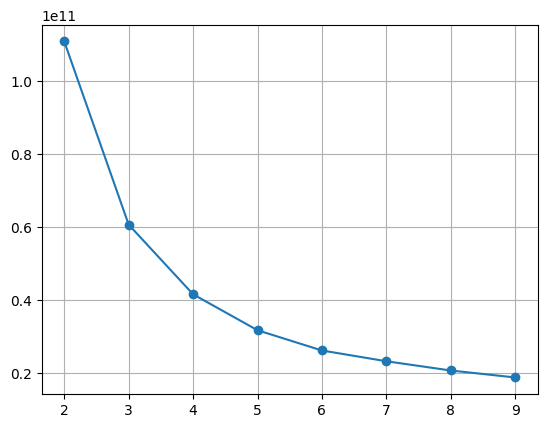

In [ ]:
plt.grid()
plt.plot(np.arange(2, 10), score1, marker='o')
plt.show()

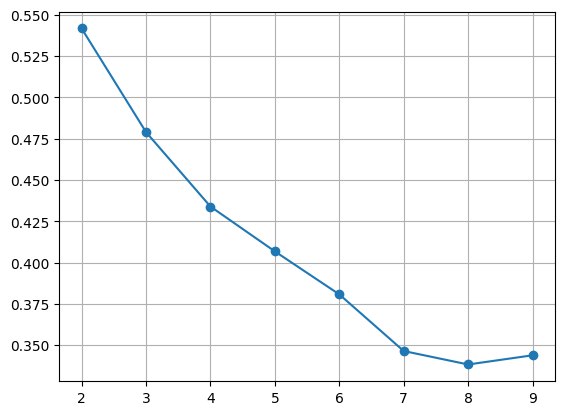

In [ ]:
plt.grid()
plt.plot(np.arange(2, 10), score2, marker='o')
plt.show()

In [ ]:
model1 = KMeans(n_clusters=2)
model1.fit(after_removel_if)
model1.cluster_centers_

array([[5.59341815e+03, 1.97279762e+03, 3.01384732e+04, 7.93154762e-01,
        3.63095238e-01, 5.10238095e+01, 3.29583333e+01, 5.18750000e+00,
        2.13333333e+01, 7.23809524e+00, 5.07738095e+00, 1.39345238e+01,
        1.98809524e+00, 2.03273810e+00, 4.25595238e-01, 3.19791667e+00,
        6.59970238e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 3.00000000e+00,
        1.10000000e+01, 0.00000000e+00],
       [5.66256731e+03, 1.96547692e+03, 5.72122462e+04, 3.46153846e-01,
        8.32692308e-01, 5.02076923e+01, 2.87750000e+02, 1.58634615e+01,
        1.12063462e+02, 2.36500000e+01, 1.61346154e+01, 3.26230769e+01,
        2.47500000e+00, 4.44615385e+00, 2.28076923e+00, 6.45961538e+00,
        4.89807692e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 3.00000000e+00,
        1.10000000e+01, 0.00000000e+00]])

In [ ]:
labelsKNN = model1.labels_

unique, counts = np.unique(labelsKNN, return_counts=True)

np.asarray((unique, counts)).T

array([[  0, 672],
       [  1, 520]])

In [ ]:
model2 = AgglomerativeClustering(2, compute_distances=True)
clastering=model2.fit(after_removel_if)

labelsAC = clastering.labels_

unique, counts = np.unique(labelsAC, return_counts=True)

np.asarray((unique, counts)).T

array([[  0, 608],
       [  1, 584]])

In [ ]:
tsne = TSNE(n_components=2, learning_rate='auto', init='random', perplexity=5)
tsne_results = tsne.fit_transform(after_removel_if)

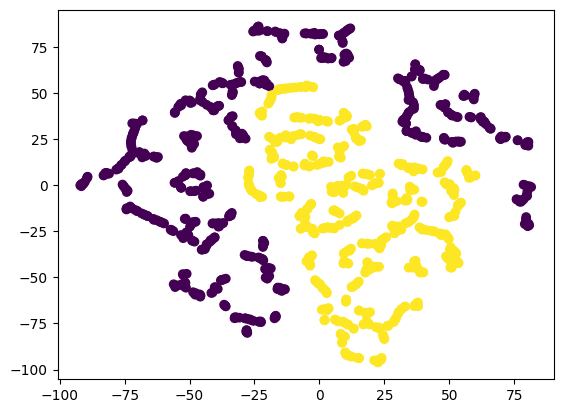

In [ ]:
plt.scatter(tsne_results[:,0], tsne_results[:,1], c=labelsAC)
plt.show()

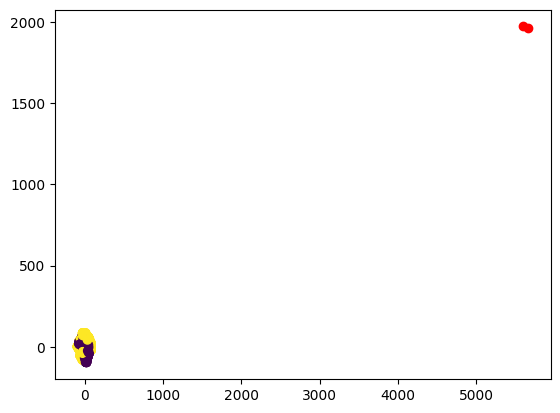

In [ ]:
plt.scatter(tsne_results[:,0], tsne_results[:,1], c=labelsKNN)
plt.scatter(model1.cluster_centers_[:,0], model1.cluster_centers_[:,1], color='red')

plt.show()

In [ ]:
fit = umap.UMAP(n_neighbors=2, min_dist=0.99)
u = fit.fit_transform(after_removel_if)

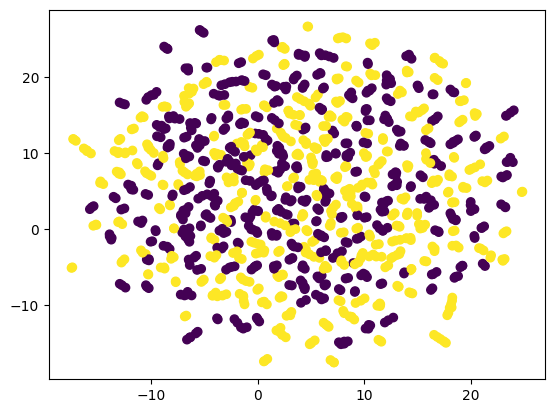

In [ ]:
plt.scatter(u[:,0], u[:,1], c=labelsAC)
plt.show()

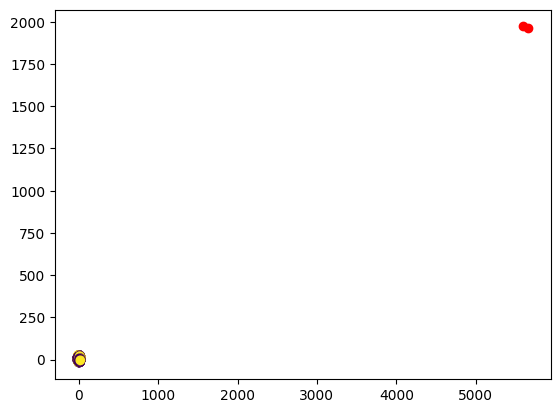

In [ ]:
plt.scatter(u[:,0], u[:,1], c=labelsKNN)
plt.scatter(model1.cluster_centers_[:,0], model1.cluster_centers_[:,1], color='red')

plt.show()